In [6]:
import pandas as pd
import numpy as np
import glob  
import plotly.graph_objs as go
import plotly.offline as py
import matplotlib.pyplot as plt
import matplotlib
plt.style.use('fivethirtyeight') 
from datetime import datetime
from folium import Map
from folium.plugins import HeatMap
import pymove
from pymove import MoveDataFrame

In [7]:
# FUNÇÃO PARA IMPORTAR DATASET

dir_path = "data/"

def importaData(files):
    
    data = dir_path + files
    allFiles = glob.glob('data/*.csv')
    list_ = []
    dtypes = {
        'ANO_BO': object,
        'NUM_BO': object,
        'DATAOCORRENCIA': object,
        'PERIDOOCORRENCIA':object,
        'BAIRRO':object,
        'CIDADE':object,
        'LATITUDE':object,
        'LONGITUDE':object,
        'LOGRADOURO':object,
        'DESCRICAOLOCAL':object,
        'DESCR_TIPO_VEICULO':object,
        'DELEGACIA_NOME': object,
        'QUANT_CELULAR': object
    }
    cols = ['ANO_BO', 'NUM_BO', 'DATAOCORRENCIA', 'PERIDOOCORRENCIA', 'BAIRRO', 'CIDADE', 'LATITUDE', 'LONGITUDE', 'LOGRADOURO', \
           'DESCRICAOLOCAL', 'DESCR_TIPO_VEICULO', 'DELEGACIA_NOME',  'QUANT_CELULAR']

    for file_ in allFiles:
        df = pd.read_csv(file_,index_col=None, header=0, delimiter=';', usecols=cols, dtype=dtypes, thousands=',')
        list_.append(df)

    df = pd.concat(list_, axis = 0, ignore_index = True)
    return df

# IMPORTANDO DATASET

dataset = importaData('*.csv')

### Tratamento dos dados

In [8]:
# REMOVENDO DADOS DUPLICADOS

def removeDuplicados(df):
    df.drop_duplicates(subset=['DELEGACIA_NOME', 'ANO_BO', 'NUM_BO'], inplace=True)
    df.reset_index(drop=True,inplace=True)
    return df

# TRANSFORMANDO STRINGS PARA LOWER CASE

def lowerCase(df, cols):
    for col in cols:
        df[col] = df[col].str.title()
    
    return df

dataset = removeDuplicados(dataset)
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1278175 entries, 0 to 1278174
Data columns (total 13 columns):
 #   Column              Non-Null Count    Dtype 
---  ------              --------------    ----- 
 0   ANO_BO              1278175 non-null  object
 1   NUM_BO              1278175 non-null  object
 2   DATAOCORRENCIA      1278172 non-null  object
 3   PERIDOOCORRENCIA    1278174 non-null  object
 4   LOGRADOURO          1224442 non-null  object
 5   BAIRRO              1093579 non-null  object
 6   CIDADE              1235274 non-null  object
 7   LATITUDE            1090572 non-null  object
 8   LONGITUDE           1090570 non-null  object
 9   DESCRICAOLOCAL      1278173 non-null  object
 10  DELEGACIA_NOME      1278172 non-null  object
 11  DESCR_TIPO_VEICULO  162023 non-null   object
 12  QUANT_CELULAR       932206 non-null   object
dtypes: object(13)
memory usage: 126.8+ MB


In [9]:
dataset['ANO_BO'] = pd.to_numeric(dataset['ANO_BO'], errors='coerce', downcast='integer')
dataset['NUM_BO'] = pd.to_numeric(dataset['NUM_BO'], errors='coerce', downcast='integer')


dataset['LATITUDE'] = dataset['LATITUDE'].replace({',':'.'}, regex=True)
dataset['LONGITUDE'] = dataset['LONGITUDE'].replace({',':'.'}, regex=True)

dataset['LATITUDE'] = pd.to_numeric(dataset['LATITUDE'], errors='coerce')
dataset['LONGITUDE'] = pd.to_numeric(dataset['LONGITUDE'], errors='coerce')

dataset['QUANT_CELULAR'] = pd.to_numeric(dataset['QUANT_CELULAR'], errors='coerce')
dataset.reset_index(drop='index',inplace=True)

In [10]:
dataset['datacorreta'] = pd.to_datetime(dataset['DATAOCORRENCIA'], format='%d/%m/%Y', errors = 'coerce')
dataset.drop(columns=['DATAOCORRENCIA'], inplace=True)
dataset.reset_index(drop='index',inplace=True)
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1278175 entries, 0 to 1278174
Data columns (total 13 columns):
 #   Column              Non-Null Count    Dtype         
---  ------              --------------    -----         
 0   ANO_BO              1278173 non-null  float64       
 1   NUM_BO              1278172 non-null  float64       
 2   PERIDOOCORRENCIA    1278174 non-null  object        
 3   LOGRADOURO          1224442 non-null  object        
 4   BAIRRO              1093579 non-null  object        
 5   CIDADE              1235274 non-null  object        
 6   LATITUDE            1090571 non-null  float64       
 7   LONGITUDE           1090569 non-null  float64       
 8   DESCRICAOLOCAL      1278173 non-null  object        
 9   DELEGACIA_NOME      1278172 non-null  object        
 10  DESCR_TIPO_VEICULO  162023 non-null   object        
 11  QUANT_CELULAR       932205 non-null   float64       
 12  datacorreta         1278137 non-null  datetime64[ns]
dtypes: datetime6

### Criando um dataset para análise espacial

In [11]:
colsToLower = ["PERIDOOCORRENCIA", "LOGRADOURO", "BAIRRO", "DESCR_TIPO_VEICULO", "CIDADE"]

spatial_analysis = lowerCase(dataset, colsToLower)
spatial_analysis = dataset[dataset['CIDADE']=='S.Paulo']

#### Removendo valores nulos de latitude e longitude

In [13]:
spatial_analysis = spatial_analysis[spatial_analysis['LONGITUDE'].notnull()]

In [16]:
spatial_analysis.drop(686741, inplace=True)
spatial_analysis.reset_index(drop='index',inplace=True)

### Criando um dataset para análise temporal

In [67]:
temporal_analysis = dataset.drop(dataset[dataset['datacorreta'].isnull()].index)

### Tratamento
Remoção de valorescom data anterior a 2010-01-01, além da remoção de tuplas com datetime nulo

In [68]:
temporal_analysis.drop(temporal_analysis[temporal_analysis['datacorreta']<'2010-01-01'].index, inplace=True)
temporal_analysis.drop(temporal_analysis[temporal_analysis['datacorreta'].isnull()].index, inplace=True)
temporal_analysis.drop(686741, inplace=True)
temporal_analysis = temporal_analysis[temporal_analysis['CIDADE']=='S.Paulo']
temporal_analysis.reset_index(drop='index',inplace=True)

In [69]:
temporal_analysis

,ANO_BO,NUM_BO,PERIDOOCORRENCIA,LOGRADOURO,BAIRRO,CIDADE,LATITUDE,LONGITUDE,DESCRICAOLOCAL,DELEGACIA_NOME,DESCR_TIPO_VEICULO,QUANT_CELULAR,datacorreta
0,2011.0,2222.0,De Madrugada,R Antonio Gandini,Conj.Jose Bonifacio,S.Paulo,-23.541350,-46.445806,Via pública,103º D.P. COHABII/ITAQU.,NaN,NaN,2011-06-01
1,2011.0,2282.0,A Noite,Rua Da Consolacao,Centro,S.Paulo,-23.548345,-46.647177,Via pública,DEL.POL.MAIRIPORÃ,NaN,1.0,2011-05-31
2,2011.0,4331.0,A Noite,R Benedito Bernardes,Vila Ema,S.Paulo,-23.580824,-46.543110,Via pública,56º D.P. VILA ALPINA,NaN,NaN,2011-05-31
3,2011.0,2014.0,De Madrugada,R Kumaki Aoki,Jd Helena,S.Paulo,-23.480922,-46.429622,Via pública,59º D.P. JARDIM DOS IPES,NaN,2.0,2011-05-31
4,2011.0,2288.0,A Noite,Av Padre Arlindo Vieira,Jardim Climax,S.Paulo,-23.622221,-46.601846,Via pública,26º D.P. SACOMA,NaN,1.0,2011-05-31
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1066743,2015.0,542079.0,Pela Manhã,Rua Conselheiro Ramalho,Bela Vista,S.Paulo,NaN,NaN,Outros,DELEGACIA ELETRONICA,NaN,1.0,2015-04-30
1066744,2015.0,541976.0,A Noite,Rua Afonso Aliperti,Agua Funda,S.Paulo,-23.634803,-46.620515,Outros,DELEGACIA ELETRONICA,Automovel,1.0,2015-04-30
1066745,2015.0,542132.0,A Noite,Avenida Vila Ema,Vila Prudente,S.Paulo,-23.577624,-46.575901,Outros,DELEGACIA ELETRONICA,NaN,1.0,2015-04-30
1066746,2015.0,542117.0,A Noite,Rua Agostinho Da Silva Monteiro,Vila Curuça,S.Paulo,-23.495224,-46.411215,Outros,DELEGACIA ELETRONICA,NaN,1.0,2015-04-30


# Modelo de predição temporal

A ideia é assim como Lucas Moretto, efetuar uma análise temporal da quantidade de ocorrências de roubos por mês

### Tratamento dos dados para geração de análise temporal por mês

In [70]:
temporal_analysis['mes_ano'] = pd.to_datetime(temporal_analysis['datacorreta'], format='%Y-%m').dt.to_period('M')
ocorrencias = temporal_analysis.groupby('mes_ano').count()['ANO_BO'].reset_index()
ocorrencias = ocorrencias.sort_values(by=['mes_ano'])
ocorrencias

,mes_ano,ANO_BO
0,2010-01,5705
1,2010-02,5427
2,2010-03,6158
3,2010-04,6011
4,2010-05,6284
...,...,...
123,2020-04,6278
124,2020-05,6461
125,2020-06,6364
126,2020-07,6251


## Import Sktime

In [28]:
import warnings
warnings.simplefilter("ignore")
from sktime.datasets import load_airline
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting.forecasting import plot_ys

(<Figure size 1152x288 with 1 Axes>, <AxesSubplot:>)

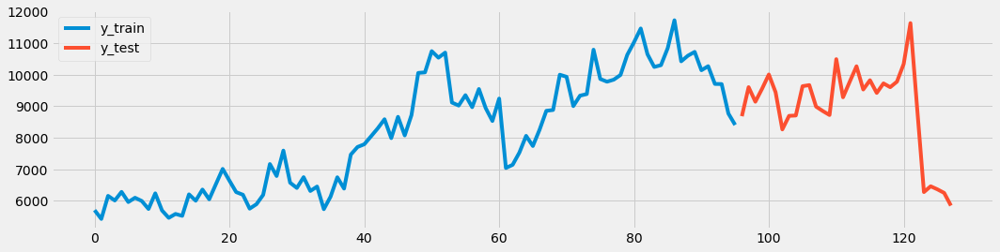

In [72]:
y = ocorrencias['ANO_BO']

y_train, y_test = temporal_train_test_split(y)
fh = np.arange(len(y_test)) + 1
#fh = ForecastingHorizon(ocorrencias.index, is_relative=False)
plot_ys(y_train, y_test, labels=["y_train", "y_test"])

## Naive Forecast com estratégia Last
Se baseia nos últimos dados de treino para criar a predição

In [73]:
from sktime.forecasting.naive import NaiveForecaster
from sktime.performance_metrics.forecasting import smape_loss

# Naive Forecaster com estratégia ''last''
naive_forecaster_last = NaiveForecaster(strategy="last")
naive_forecaster_last.fit(y_train)


NaiveForecaster()

## Naive Forecaster com estratégia last
Essa estratégia se baseia nos ultimos dados e faz um season period de meses igual a 12

SMAPE para estratégia last:  0.14814783659149372
SMAPE para estratégia last com season period 12:  0.16932629822452483


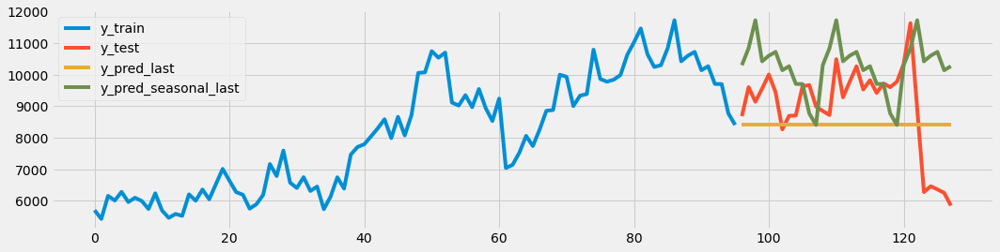

In [74]:
y_last = naive_forecaster_last.predict(fh)
# Naive Forecaster com estratégia ''seasonal_last'' e sp = 12
naive_forecaster_seasonal_last = NaiveForecaster(strategy="last", sp = 12)
naive_forecaster_seasonal_last.fit(y_train)
y_seasonal_last = naive_forecaster_seasonal_last.predict(fh)

plot_ys(y_train, y_test, y_last,y_seasonal_last, labels=["y_train", "y_test", "y_pred_last","y_pred_seasonal_last"]);
print('SMAPE para estratégia ''last'': ', smape_loss(y_last, y_test))
print('SMAPE para estratégia ''last'' com season period 12: ', smape_loss(y_seasonal_last, y_test))

## NaiveForecaster com estratégia média


SMAPE para estratégia média:  0.17496795185801411


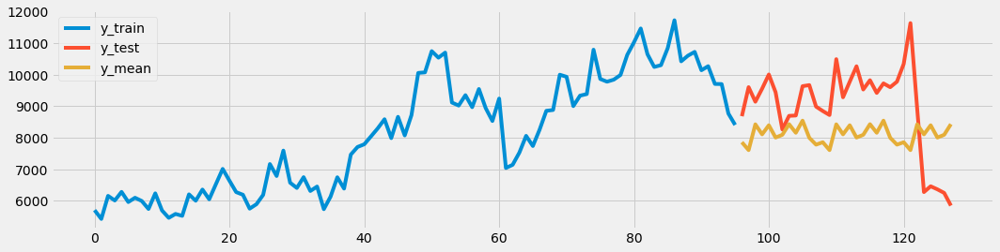

In [75]:
from sktime.forecasting.naive import NaiveForecaster
from sktime.performance_metrics.forecasting import smape_loss

naive_ = NaiveForecaster(strategy="mean", sp = 12)
naive_.fit(y_train)
y_mean = naive_.predict(fh)

plot_ys(y_train, y_test, y_mean, labels=["y_train", "y_test", "y_mean"]);
print('SMAPE para estratégia ''média'': ', smape_loss(y_mean, y_test))

## Naive Forecaster com estratégia drift


SMAPE para estratégia seasonal_last:  0.1280234616997623


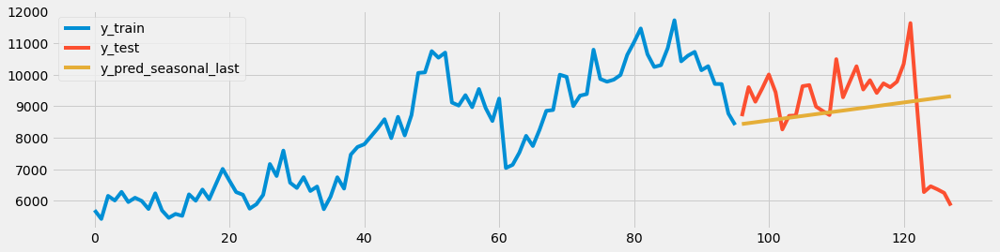

In [76]:
from sktime.forecasting.naive import NaiveForecaster
from sktime.performance_metrics.forecasting import smape_loss

naive_ = NaiveForecaster(strategy="drift", sp = 12)
naive_.fit(y_train)
y_season = naive_.predict(fh)

plot_ys(y_train, y_test, y_season, labels=["y_train", "y_test", "y_pred_seasonal_last"]);
print('SMAPE para estratégia ''seasonal_last'': ', smape_loss(y_season, y_test))

## ReducedRegression
Com regressor RandomForest

SMAPE para Regressão com RandomForest:  0.1494710076782009


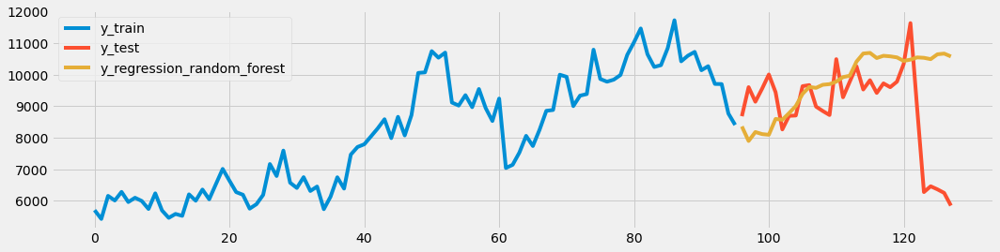

In [77]:
import numpy as np
from sktime.datasets import load_airline
from sktime.forecasting.compose import ReducedRegressionForecaster
from sklearn.ensemble import RandomForestRegressor
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.performance_metrics.forecasting import smape_loss

y_train, y_test = temporal_train_test_split(y)
fh = np.arange(1, len(y_test) + 1)  # forecasting horizon
regressor = RandomForestRegressor()
forecaster = ReducedRegressionForecaster(regressor, window_length=12)
forecaster.fit(y_train)
y_regression_random_forest = forecaster.predict(fh)
plot_ys(y_train, y_test, y_regression_random_forest, labels=["y_train", "y_test", "y_regression_random_forest"]);
print('SMAPE para Regressão com RandomForest: ', smape_loss(y_test, y_regression_random_forest))

## Scikit Learn com KNN Regressor
Usando KNN do Scikit Learn e o modelo ReducedRegressionForecaster

SMAPE para Regressão usando KNN com RandomForest:  0.16846881956128518


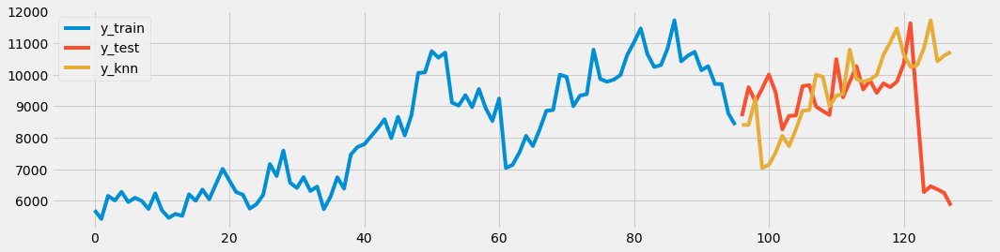

In [78]:
from sklearn.neighbors import KNeighborsRegressor

regressor = KNeighborsRegressor(n_neighbors=1)
forecaster = ReducedRegressionForecaster(regressor=regressor, window_length=12, strategy="recursive")
forecaster.fit(y_train)
y_knn = forecaster.predict(fh)
plot_ys(y_train, y_test, y_knn, labels=["y_train", "y_test", "y_knn"]);
print('SMAPE para Regressão usando KNN com RandomForest: ', smape_loss(y_test, y_knn))

## ReducedRegressionForecaster

SMAPE usando Floresta Aleatória:  0.12339486745566547


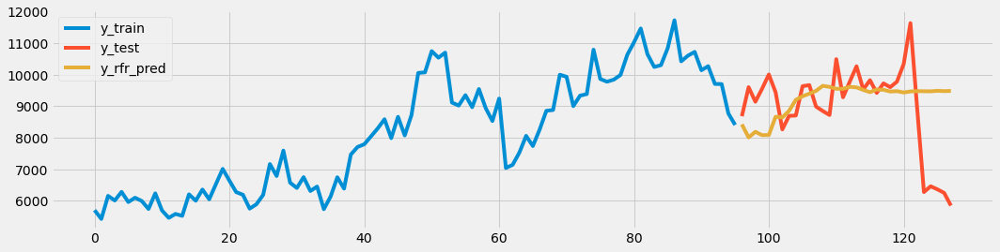

In [79]:
from sktime.forecasting.compose import ReducedRegressionForecaster
from sklearn.ensemble import RandomForestRegressor

rfr = RandomForestRegressor()
rfr_forecaster = ReducedRegressionForecaster(rfr, window_length=12)
rfr_forecaster.fit(y_train)
y_rfr_pred = rfr_forecaster.predict(fh)

plot_ys(y_train, y_test, y_rfr_pred, labels=['y_train', 'y_test', 'y_rfr_pred'])
print('SMAPE usando Floresta Aleatória: ', smape_loss(y_rfr_pred, y_test))

## ExponentialSomoothing

/home/everson/miniconda3/envs/py3k/lib/python3.7/site-packages/statsmodels/tsa/holtwinters/model.py:922: ConvergenceWarning:

Optimization failed to converge. Check mle_retvals.



SMAPE usando ExponentialSmoothing:  0.11949604097409822


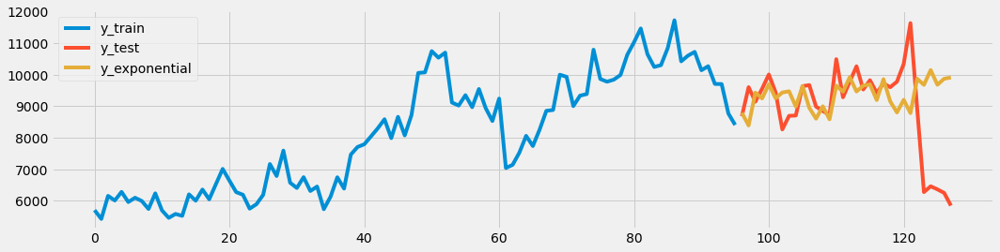

In [80]:
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
forecaster = ExponentialSmoothing(trend="add", seasonal="multiplicative", sp=12)
forecaster.fit(y_train)
y_exponential = forecaster.predict(fh)
plot_ys(y_train, y_test, y_exponential, labels=["y_train", "y_test", "y_exponential"]);
print('SMAPE usando ExponentialSmoothing: ', smape_loss(y_exponential, y_test))

## SlidingWindow e GridSearchCV


SMAPE usando Grid Search:  0.12544313205510527


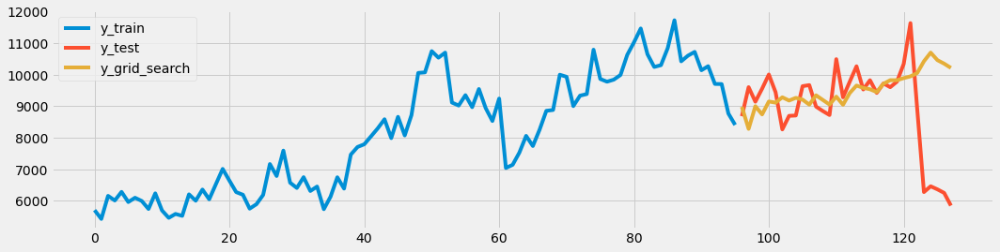

In [81]:
from sktime.forecasting.model_selection import SlidingWindowSplitter
from sktime.forecasting.model_selection import ForecastingGridSearchCV

rfr = RandomForestRegressor()
forecaster = ReducedRegressionForecaster(regressor=rfr, window_length=15, strategy="recursive")
param_grid = {"window_length": [3, 6, 9]}

# we fit the forecaster on the initial window, and then use temporal cross-validation to find the optimal parameter
cv = SlidingWindowSplitter(initial_window=int(len(y_train) * 0.5))
gscv = ForecastingGridSearchCV(forecaster, cv=cv, param_grid=param_grid)
gscv.fit(y_train)
y_grid_search = gscv.predict(fh)
plot_ys(y_train, y_test, y_grid_search, labels=["y_train", "y_test", "y_grid_search"]);
print('SMAPE usando Grid Search: ', smape_loss(y_grid_search, y_test))

# PyMove

In [ ]:
import pymove
from pymove import MoveDataFrame

In [83]:
move_df = MoveDataFrame(data=spatial_analysis, latitude="LATITUDE", longitude="LONGITUDE", datetime="datacorreta", traj_id="NUM_BO")

In [84]:
pymove.visualization.folium.faster_cluster(move_df)

HeatMap apenas para alguns locais (bairros)

In [91]:
pymove.visualization.folium.heatmap(move_data=move_df[move_df['ANO_BO']==2019], zoom_start=10)

## K-Means

In [92]:
X = np.array(spatial_analysis[['LATITUDE','LONGITUDE']])

### Método do cotovelo
Inviável de ser executado para um número de clusters maior que 10

In [ ]:
def number_of_clusters(dataset, n_clusters):
    wcss = []
    for n in range(2, n_clusters+1):
        kmeans = KMeans(n_clusters=n)
        kmeans.fit(dataset)
        wcss.append(kmeans.inertia_)

    x1, y1 = 2, wcss[0]
    x2, y2 = n_clusters, wcss[len(wcss)-1]

    distances = []
    for i in range(len(wcss)):
        x0 = i+2
        y0 = wcss[i]
        numerator = abs((y2-y1)*x0 - (x2-x1)*y0 + x2*y1 - y2*x1)
        denominator = np.sqrt((y2 - y1)**2 + (x2 - x1)**2)
        distances.append(numerator/denominator)
    
    return distances.index(max(distances)) + 2

### K-Means com 10 clusters

Inércia =  1853.9785816552157


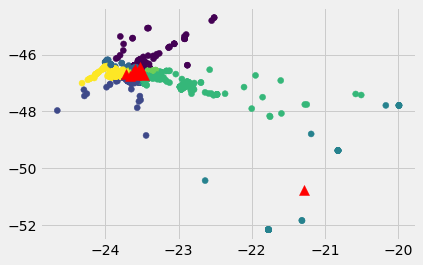

In [93]:
from sklearn.cluster import KMeans
kmeans_scikit = KMeans(n_clusters=10, random_state=0).fit(X)

print("Inércia = ", kmeans_scikit.inertia_)

plt.scatter(X[:,0], X[:,1], c=kmeans_scikit.labels_)
plt.scatter(kmeans_scikit.cluster_centers_[:,0], 
            kmeans_scikit.cluster_centers_[:,1], marker='^', c='red', s=100)
plt.show()

In [94]:
clusters = pd.DataFrame(kmeans_scikit.cluster_centers_, columns=['lat','lon'])
unique_elements, counts_elements = np.unique(kmeans_scikit.labels_, return_counts=True)
unique_elements, counts_elements
clusters['qtde'] = counts_elements
clusters['id'] = unique_elements
clusters['datetime'] = datetime.now().strftime("%d/%m/%Y")
clusters

,lat,lon,qtde,id,datetime
0,-23.523273,-46.426961,125609,0,21/10/2020
1,-23.543753,-46.642433,167077,1,21/10/2020
2,-23.664599,-46.757119,90278,2,21/10/2020
3,-23.589579,-46.495089,112349,3,21/10/2020
4,-21.283224,-50.766967,50,4,21/10/2020
5,-23.583956,-46.727212,81108,5,21/10/2020
6,-23.475077,-46.706576,88429,6,21/10/2020
7,-23.509044,-46.565420,86182,7,21/10/2020
8,-23.621947,-46.627542,114266,8,21/10/2020
9,-23.716935,-46.678060,80943,9,21/10/2020


In [95]:
mv_df = MoveDataFrame(data=clusters, latitude="lat", longitude="lon", datetime="datetime", traj_id="id")

### Usando Pymove para plotar mapa com clusters

In [96]:
pymove.visualization.folium.plot_markers(move_data=mv_df, zoom_start=10)